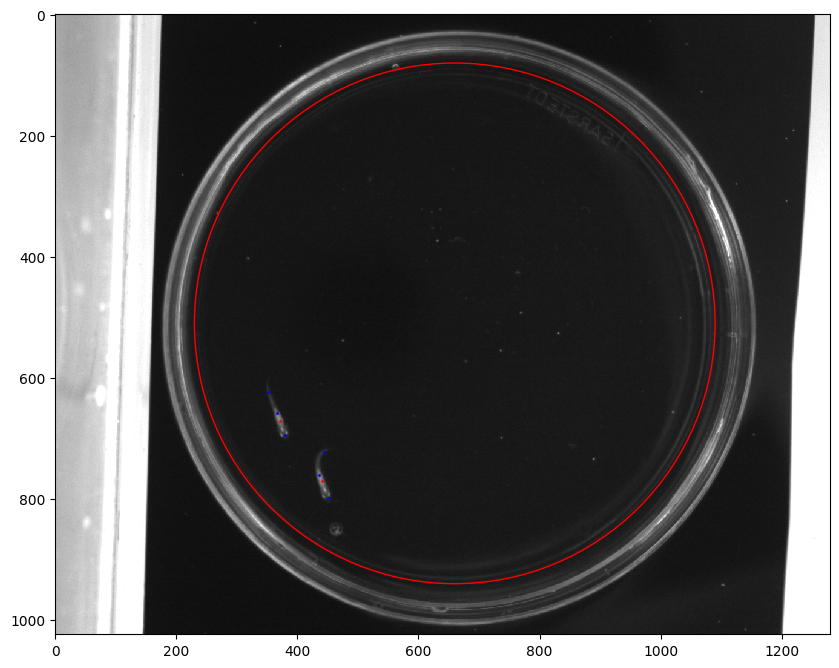

In [37]:
import numpy as np
import matplotlib.pyplot as plt
#Plot the animation
from matplotlib.animation import FuncAnimation
pos=np.load('data_npy/2.npy')
vid=np.load('data_video/2.npy')
midline=np.load('data_midline/2_consistent.npy')
DATA_circle=np.load('data_circle/2.npy')
#3584*3400
fig, ax = plt.subplots(figsize=(10, 10))
ax.plot(pos[0,:,0], pos[0,:,1], 'o', color='red', markersize=1)
ax.plot(midline[0,:,0,0], midline[0,:,0,1], 'o', color='blue', markersize=1)
ax.plot(midline[0,:,1,0], midline[0,:,1,1], 'o', color='blue', markersize=1)
ax.plot(midline[0,:,2,0], midline[0,:,2,1], 'o', color='blue', markersize=1)
x,y,r=DATA_circle
circle=plt.Circle((x, y), r, color='r',fill=False)
ax.add_patch(circle)
ax.imshow(vid, interpolation='nearest')

In [233]:
head=midline[:,:,0,:]-midline[:,:,1,:]
tail=midline[:,:,2,:]-midline[:,:,1,:]
def angle_between_2vec(vec1, vec2, axis=2):
    """Calculate the angle between two vectors."""
    return np.arctan2(
        np.cross(vec1, vec2, axis=axis),
        np.sum(vec1 * vec2, axis=axis)
    )
position=midline[:,:,1,:]-DATA_circle[None,None,:2]
global_head_phi=angle_between_2vec(head,-position, axis=2)
theta=angle_between_2vec(-head, tail, axis=2)
L1=np.linalg.norm(head, axis=2)
L2=np.linalg.norm(tail, axis=2)
R=300
Observed_vector=midline[:,None,:,1,:]-midline[:,:,None,1,:]
Observed_distance=np.linalg.norm(Observed_vector, axis=3)
Observed_phi=angle_between_2vec(head[:,:,None,:], Observed_vector, axis=3)
Observed_head_phi=angle_between_2vec(Observed_vector,head[:,None,:,:], axis=3)
Observed_index=Observed_distance<=R

In [587]:
Radius=r-np.linalg.norm(position, axis=2)
Time=pos.shape[0]
print(Radius.shape)
Radius[Radius>R]=-1

(19365, 2)


In [68]:
print(global_head_phi)

[[-1.66321455 -2.03678866]
 [-1.72178398 -2.21702234]
 [-1.85962361 -2.18125739]
 ...
 [ 0.11778194  1.8078771 ]
 [ 0.14450231  1.77921653]
 [ 0.12696673  1.84981618]]


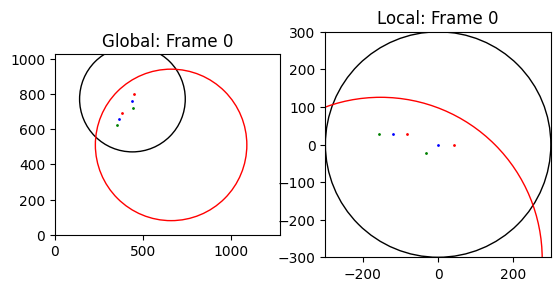

In [380]:
Observer_index=1
fig, [ax1,ax2] = plt.subplots(nrows=1, ncols=2)
t_start=0
def animate(i):
    i+=t_start
    ax1.clear()
    ax2.clear()
    ax1.plot(midline[i,:,0,0], midline[i,:,0,1], 'o', color='red', markersize=1)
    ax1.plot(midline[i,:,1,0], midline[i,:,1,1], 'o', color='blue', markersize=1)
    ax1.plot(midline[i,:,2,0], midline[i,:,2,1], 'o', color='green', markersize=1)
    circle = plt.Circle((pos[i,Observer_index,0], pos[i,Observer_index,1]), R, color='black', fill=False)
    ax1.add_artist(circle)
    ax1.set_xlim(0, vid.shape[1])
    ax1.set_ylim(0, vid.shape[0])
    ax1.set_aspect('equal', adjustable='box')
    ax1.set_title(f"Global: Frame {i}")
    circle=plt.Circle((x, y), r, color='r',fill=False)
    ax1.add_patch(circle)

    Each_obs_index=Observed_index[i,Observer_index]
    CM_x=Observed_distance[i,Observer_index,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index])
    CM_y=Observed_distance[i,Observer_index,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index])
    ax2.plot(L1[i,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index])+CM_x, \
            L1[i,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index])+CM_y, \
                'o', color='red', markersize=1)
    ax2.plot(CM_x,CM_y, \
                'o', color='blue', markersize=1)
    ax2.plot(L2[i,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index]+np.pi+theta[i,Each_obs_index])+CM_x, \
            L2[i,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index]+np.pi+theta[i,Each_obs_index])+CM_y, 'o', color='green', markersize=1)
    circle = plt.Circle((0, 0), R, color='black', fill=False)
    ax2.add_artist(circle)
    ax2.set_xlim(-R, R)
    ax2.set_ylim(-R, R)
    ax2.set_title(f"Local: Frame {i}")
    ax2.set_aspect('equal', adjustable='box')
    if Radius[i,Observer_index]!=-1:
        circle=plt.Circle(((r-Radius[i,Observer_index])*np.cos(-global_head_phi[i,Observer_index]), -(r-Radius[i,Observer_index])*np.sin(-global_head_phi[i,Observer_index])), r, color='r',fill=False)
    ax2.add_patch(circle)
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())

In [404]:
angular_speed= angle_between_2vec(head[:-1,:,:],head[1:,:,:], axis=2)
velocity =midline[1:,:,1,:]-midline[:-1,:,1,:]
speed=np.linalg.norm(velocity, axis=2)
velocity_phi=angle_between_2vec(head[:-1,:,:],velocity,axis=2)
v_para=speed*np.cos(velocity_phi)
v_norm=speed*np.sin(velocity_phi)
L1_dot=L1[1:]-L1[:-1]
L2_dot=L2[1:]-L2[:-1]
theta_dot=theta[1:]-theta[:-1]

In [405]:
print(angular_speed)

[[ 0.03886772  0.15023413]
 [ 0.11665238 -0.0555131 ]
 [-0.10860161  0.00151173]
 ...
 [ 0.2562535  -0.36235252]
 [-0.02100067  0.10785179]
 [ 0.02246697 -0.03629369]]


MLP:

Input: L1,L2,theta,L1_dot,L2_dot,theta_dot

Output: v_para,v_norm,angular_speed

In [ ]:
INPUT=np.stack([L1[:-1],L2[:-1],theta[:-1],L1_dot,L2_dot,theta_dot,Radius[:-1],g],axis=2)
OUTPUT=np.stack([v_para,v_norm,angular_speed],axis=2)
print("Input shape",INPUT.shape)
print("Output shape",OUTPUT.shape)

Input shape (19364, 2, 6)
Output shape (19364, 2, 3)


In [604]:
OUTLIER_PER=99
mean=np.empty((INPUT.shape[1], INPUT.shape[2]))
std=np.empty((INPUT.shape[1], INPUT.shape[2]))
OUTLIER_INDEX=np.zeros(INPUT.shape[0],dtype=bool)
for fish_id in range(INPUT.shape[1]):
    for num_feature in range(INPUT.shape[2]):
        a=np.percentile(INPUT[:,fish_id,num_feature],OUTLIER_PER)
        OUTLIER_INDEX |= (np.abs(INPUT[:, fish_id, num_feature]) >= a)
Refined_INPUT=INPUT[(~OUTLIER_INDEX).nonzero()[0]]
Refined_OUTPUT=OUTPUT[(~OUTLIER_INDEX).nonzero()[0]]
for fish_id in range(Refined_INPUT.shape[1]):
    for num_feature in range(Refined_INPUT.shape[2]):
        mean[fish_id, num_feature] = np.mean(Refined_INPUT[:, fish_id, num_feature])
        std[fish_id, num_feature] = np.std(Refined_INPUT[:, fish_id, num_feature])
        # Normalize the input features
        Refined_INPUT[:, fish_id, num_feature] = (Refined_INPUT[:, fish_id, num_feature] - mean[fish_id, num_feature]) / std[fish_id, num_feature]
        

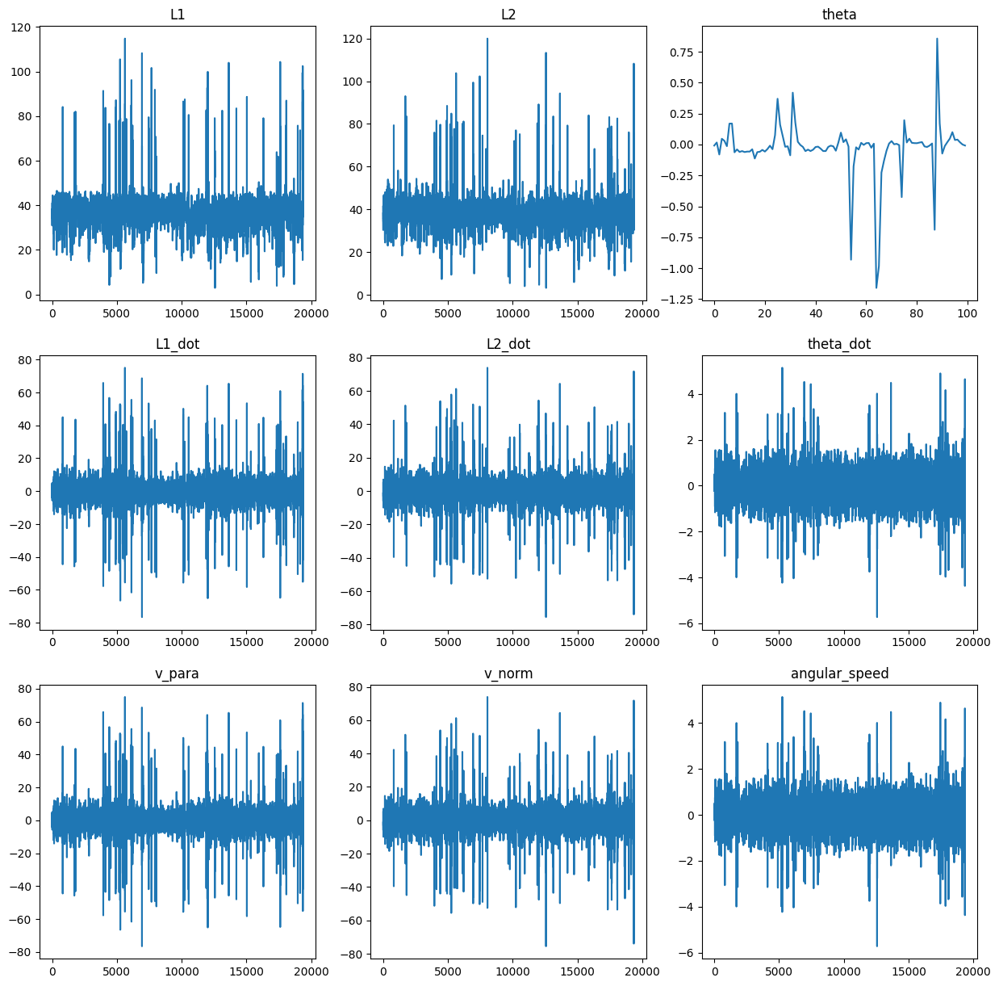

In [603]:
fig,ax=plt.subplots(nrows=3, ncols=3 ,figsize=(15,15))
ax[0,0].set_title("L1")
ax[0,0].plot(INPUT[:,0,0])
ax[0,1].set_title("L2")
ax[0,1].plot(INPUT[:,0,1])
ax[0,2].set_title("theta")
ax[0,2].plot(INPUT[:100,0,2])
ax[1,0].set_title("L1_dot")
ax[1,0].plot(INPUT[:,0,3])
ax[1,1].set_title("L2_dot")
ax[1,1].plot(INPUT[:,0,4])
ax[1,2].set_title("theta_dot")
ax[1,2].plot(INPUT[:,0,5])
ax[2,0].set_title("v_para")
ax[2,0].plot(OUTPUT[:,0,0])
ax[2,1].set_title("v_norm")
ax[2,1].plot(OUTPUT[:,0,1])
ax[2,2].set_title("angular_speed")
ax[2,2].plot(OUTPUT[:,0,2])

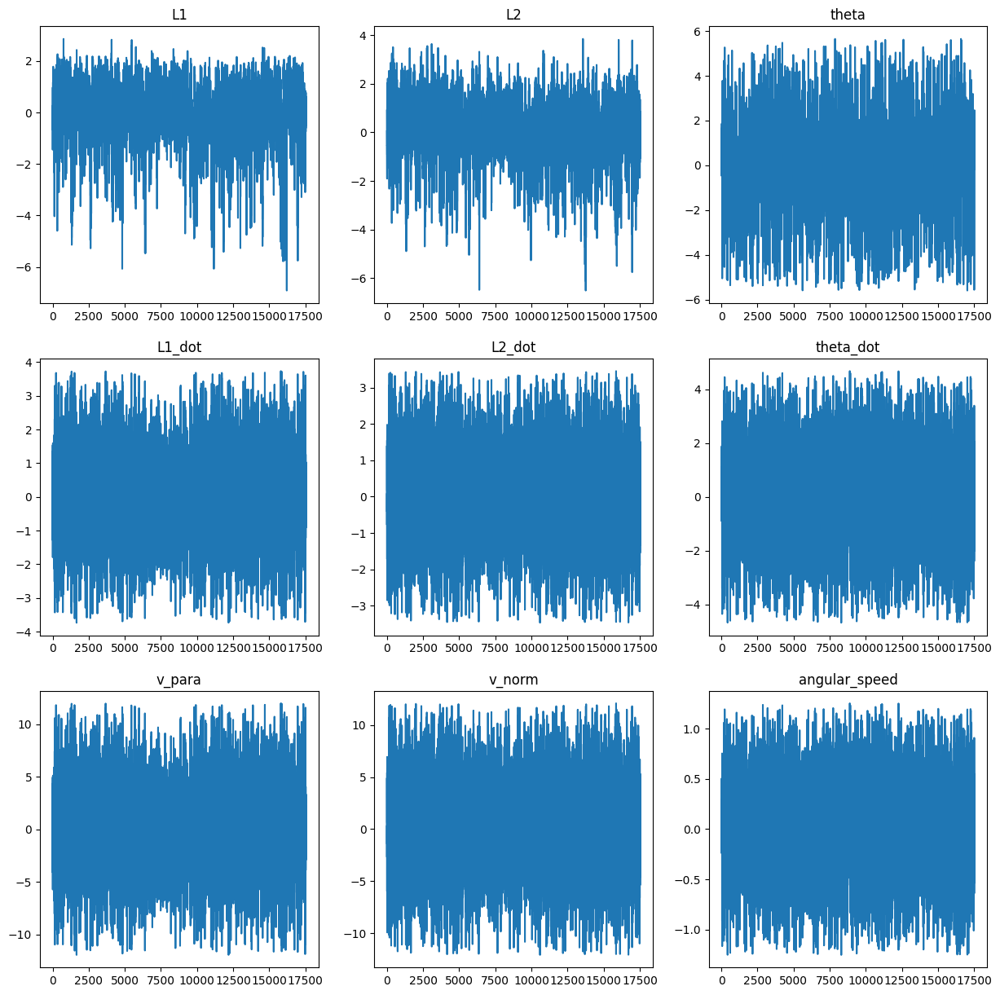

In [605]:
fig,ax=plt.subplots(nrows=3, ncols=3 ,figsize=(15,15))
ax[0,0].set_title("L1")
ax[0,0].plot(Refined_INPUT[:,0,0])
ax[0,1].set_title("L2")
ax[0,1].plot(Refined_INPUT[:,0,1])
ax[0,2].set_title("theta")
ax[0,2].plot(Refined_INPUT[:,0,2])
ax[1,0].set_title("L1_dot")
ax[1,0].plot(Refined_INPUT[:,0,3])
ax[1,1].set_title("L2_dot")
ax[1,1].plot(Refined_INPUT[:,0,4])
ax[1,2].set_title("theta_dot")
ax[1,2].plot(Refined_INPUT[:,0,5])
ax[2,0].set_title("v_para")
ax[2,0].plot(Refined_OUTPUT[:,0,0])
ax[2,1].set_title("v_norm")
ax[2,1].plot(Refined_OUTPUT[:,0,1])
ax[2,2].set_title("angular_speed")
ax[2,2].plot(Refined_OUTPUT[:,0,2])

In [606]:
print((OUTLIER_INDEX).nonzero())

(array([   11,    13,    14, ..., 19356, 19360, 19361]),)


In [463]:
import torch
import torch.nn as nn
import torch.nn.functional as F
torch.manual_seed(0)
class MotionMLP(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_dim1=64, hidden_dim2=32):
        super(MotionMLP, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim1)    # Input to first hidden layer
        self.fc2 = nn.Linear(hidden_dim1, hidden_dim2)  # First to second hidden layer
        self.fc3 = nn.Linear(hidden_dim2, output_dim)    # Second hidden to output layer

        # Optional: Add batch normalization
        self.bn1 = nn.BatchNorm1d(hidden_dim1)
        self.bn2 = nn.BatchNorm1d(hidden_dim2)
        
    def forward(self, x):
        x = F.relu(self.bn1(self.fc1(x)))
        x = F.relu(self.bn2(self.fc2(x)))
        x = self.fc3(x)  # No activation for output (linear activation)
        return x
# Example usage
model = MotionMLP(input_dim=6, output_dim=3)

In [464]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.MSELoss()

In [ ]:
from tqdm import tqdm
NUM_EPOCHS=100
losses=[]
best_loss=0
for epoch in range(NUM_EPOCHS):
    epoch_loss=[]
    for time in tqdm(range(Refined_INPUT.shape[0])):
        input_data = torch.tensor(Refined_INPUT[time], dtype=torch.float32)
        target_data = torch.tensor(Refined_OUTPUT[time], dtype=torch.float32)
        optimizer.zero_grad()
        output = model(input_data)
        loss = criterion(output, target_data)
        epoch_loss.append(loss.item())
        loss.backward()
        optimizer.step()
    losses.append(np.array(np.mean(epoch_loss)))
    if losses[-1] < best_loss or best_loss == 0:
        best_loss = losses[-1]
        torch.save(model.state_dict(), 'Model/MotionMLP.pt')
    print(f"Epoch {epoch+1}/{NUM_EPOCHS}, Loss: {losses[-1]}")

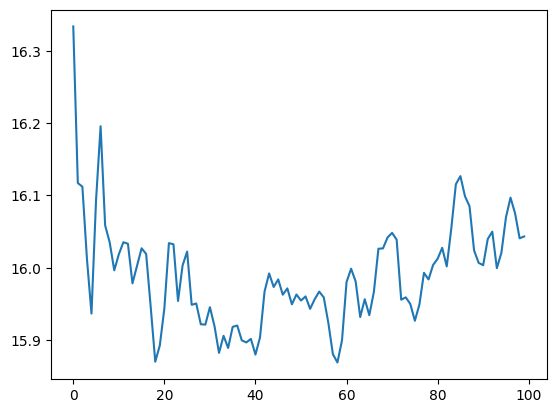

In [466]:
plt.plot(losses)

In [458]:
model.load_state_dict(torch.load('Model/MotionMLP.pt'))

/tmp/ipykernel_756141/3896682174.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('Model/MotionMLP.pt'))


<All keys matched successfully>

In [ ]:
Refined_INPUT=INPUT
Refined_OUTPUT=OUTPUT
for fish_id in range(Refined_INPUT.shape[1]):
    for num_feature in range(Refined_INPUT.shape[2]):
        mean[fish_id, num_feature] = np.mean(Refined_INPUT[:, fish_id, num_feature])
        std[fish_id, num_feature] = np.std(Refined_INPUT[:, fish_id, num_feature])
        # Normalize the input features
        Refined_INPUT[:, fish_id, num_feature] = (Refined_INPUT[:, fish_id, num_feature] - mean[fish_id, num_feature]) / std[fish_id, num_feature]

In [552]:
Predict_output=np.zeros((Refined_INPUT.shape[0], 2, 3))
with torch.no_grad():
    for time in tqdm(range(Refined_INPUT.shape[0])):
        input_data = torch.tensor(Refined_INPUT[time], dtype=torch.float32)
        Predict_output[time] = model(input_data)

  0%|          | 0/16900 [00:00<?, ?it/s]


RuntimeError: Expected 3D (unbatched) or 4D (batched) input to conv2d, but got input of size: [2, 6]

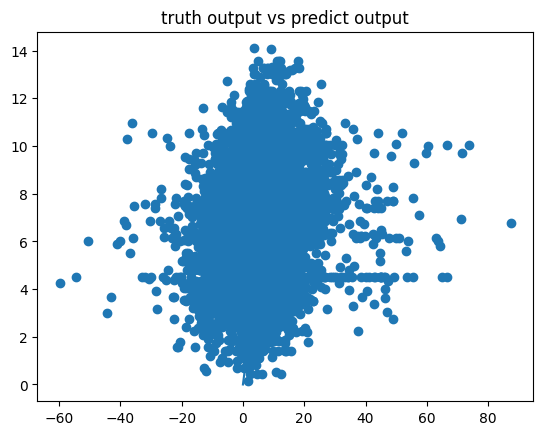

In [460]:
plt.title('truth output vs predict output')
plt.scatter(OUTPUT[:, 0, 0],Predict_output[:, 0, 0])
plt.plot([0,12],[0,12])

In [461]:
def Move(midline,L1_dot,L2_dot,theta_dot,OUTPUT):
    head=midline[:,0,:]-midline[:,1,:]
    tail=midline[:,2,:]-midline[:,1,:]
    theta=angle_between_2vec(-head, tail, axis=1)
    L1=np.linalg.norm(head, axis=1)
    L2=np.linalg.norm(tail, axis=1)
    v_para=OUTPUT[:,0]
    v_norm=OUTPUT[:,1]
    angular_speed=OUTPUT[:,2]
    head_phi=np.arctan2(head[:,1], head[:,0])
    new_head_phi=head_phi+angular_speed
    new_L1=L1+L1_dot
    new_L2=L2+L2_dot
    new_theta=theta+theta_dot
    new_head=new_L1[:,None]*(np.array([np.cos(new_head_phi), np.sin(new_head_phi)]).T)
    new_tail=new_L2[:,None]*(np.array([np.cos(new_head_phi+np.pi+new_theta), np.sin(new_head_phi+np.pi+new_theta)]).T)
    para=np.array([np.cos(head_phi), np.sin(head_phi)]).T
    Norm=np.array([-np.sin(head_phi), np.cos(head_phi)]).T
    new_velocity=v_para[:,None]*para+v_norm[:,None]*Norm
    body=midline[:,1,:]
    new_body=body + new_velocity
    new_midline=np.zeros((body.shape[0], 3, 2))
    new_midline[:,0]=new_head+new_body
    new_midline[:,1]=new_body
    new_midline[:,2]=new_tail+new_body
    return new_midline
midline_list=np.zeros_like(midline)
midline_list[0]=midline[0]
for i in range(midline.shape[0]-1):
    midline_list[i+1]=Move(midline_list[i],L1_dot[i],L2_dot[i],theta_dot[i], Predict_output[i])



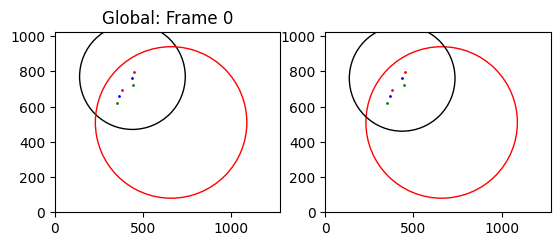

In [462]:
fig, [ax1,ax2] = plt.subplots(nrows=1, ncols=2)
def animate(i):
    ax1.clear()
    ax2.clear()
    ax1.plot(midline[i,:,0,0], midline[i,:,0,1], 'o', color='red', markersize=1)
    ax1.plot(midline[i,:,1,0], midline[i,:,1,1], 'o', color='blue', markersize=1)
    ax1.plot(midline[i,:,2,0], midline[i,:,2,1], 'o', color='green', markersize=1)
    circle = plt.Circle((pos[i,Observer_index,0], pos[i,Observer_index,1]), R, color='black', fill=False)
    ax1.add_artist(circle)
    ax1.set_xlim(0, vid.shape[1])
    ax1.set_ylim(0, vid.shape[0])
    ax1.set_aspect('equal', adjustable='box')
    ax1.set_title(f"Global: Frame {i}")
    circle=plt.Circle((x, y), r, color='r',fill=False)
    ax1.add_patch(circle)
    circle=plt.Circle((x, y), r, color='r',fill=False)
    ax2.set_xlim(0, vid.shape[1])
    ax2.set_ylim(0, vid.shape[0])
    ax2.set_aspect('equal', adjustable='box')
    ax2.add_patch(circle)
    ax2.plot(midline_list[i,:,0,0], midline_list[i,:,0,1], 'o', color='red', markersize=1)
    ax2.plot(midline_list[i,:,1,0], midline_list[i,:,1,1], 'o', color='blue', markersize=1)
    ax2.plot(midline_list[i,:,2,0], midline_list[i,:,2,1], 'o', color='green', markersize=1)
    circle = plt.Circle((midline_list[i,Observer_index,1,0], midline_list[i,Observer_index,1,1]), R, color='black', fill=False)
    ax2.add_patch(circle)
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
HTML(ani.to_jshtml())

In [511]:
import torch.nn as nn

class BasicBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        
        self.shortcut = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out += self.shortcut(x)
        out = self.relu(out)
        return out

class ResNet18(nn.Module):
    def __init__(self,in_channels=grid,num_channel=4, num_classes=6):
        super(ResNet18, self).__init__()
        self.in_channels = in_channels
        self.conv1 = nn.Conv2d(num_channel, in_channels, kernel_size=num_channel, stride=1, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(in_channels)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=num_channel, stride=2, padding=1)
        
        self.layer1 = self._make_layer(BasicBlock, in_channels, 2, stride=1)
        self.layer2 = self._make_layer(BasicBlock, 2*in_channels, 2, stride=2)
        self.layer3 = self._make_layer(BasicBlock, 4*in_channels, 2, stride=2)
        self.layer4 = self._make_layer(BasicBlock, 8*in_channels, 2, stride=2)

        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(8*in_channels, num_classes)

    def _make_layer(self, block, out_channels, num_blocks, stride):
        strides = [stride] + [1] * (num_blocks - 1)
        layers = []
        for stride in strides:
            layers.append(block(self.in_channels, out_channels, stride))
            self.in_channels = out_channels
        return nn.Sequential(*layers)

    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.maxpool(out)
        
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        
        out = self.avgpool(out)
        out = out.view(out.size(0), -1)
        out = self.fc(out)
        return out
model = ResNet18()

In [512]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.MSELoss()

CNN

In [467]:
def mid_point_circle_algorithm(radius):
    """
    使用中點圓算法生成圓的邊界點。
    radius: 圓的半徑
    回傳: 圓的邊界點列表 [(x, y), ...]
    """
    points = []
    x = radius
    y = 0
    d = 1 - radius  # 初始決策參數

    while x >= y:
        # 八分之一對稱性
        points.append((x, y))
        points.append((y, x))
        points.append((-x, y))
        points.append((-y, x))
        points.append((-x, -y))
        points.append((-y, -x))
        points.append((x, -y))
        points.append((y, -x))

        y += 1

        if d <= 0:
            d += 2 * y + 1  # 垂直方向移動
        else:
            x -= 1
            d += 2 * y - 2 * x + 1  # 水平方向移動

    return points

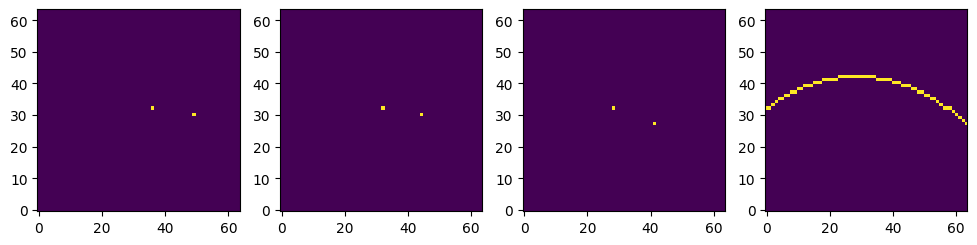

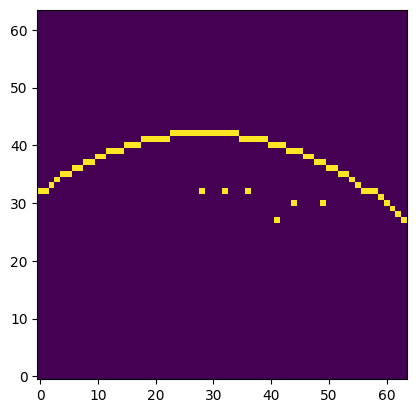

In [560]:
grid=64
scale=(grid//2)/R
def DiscreteImage(i,Observer_index,Observed_index=Observed_index,Observed_distance=Observed_distance,Observed_phi=Observed_phi,L1=L1,L2=L2,theta=theta,Radius=Radius,global_head_phi=global_head_phi,Observed_head_phi=Observed_head_phi):
    Each_obs_index=Observed_index[i,Observer_index]
    CM_x=Observed_distance[i,Observer_index,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index])
    CM_y=Observed_distance[i,Observer_index,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index])
    head=np.array([L1[i,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index])+CM_x, \
            L1[i,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index])+CM_y]).T
    body=np.array([CM_x,CM_y]).T
    tail=np.array([L2[i,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index]+np.pi+theta[i,Each_obs_index])+CM_x, \
            L2[i,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index]+np.pi+theta[i,Each_obs_index])+CM_y]).T
    head=(head*scale).astype(int)
    body=(body*scale).astype(int)
    tail=(tail*scale).astype(int)
    if Radius[i,Observer_index]!=-1:
        circle=mid_point_circle_algorithm(r*scale)
        center=np.array([(r-Radius[i,Observer_index])*np.cos(-global_head_phi[i,Observer_index]), -(r-Radius[i,Observer_index])*np.sin(-global_head_phi[i,Observer_index])])
        circle=np.array(circle)+(center*scale)[None,:]
        circle=circle.astype(int)
    Image=np.zeros((4,grid, grid))
    for pixel in head:
        if pixel[0]+grid//2>=0 and pixel[1]+grid//2>=0 and pixel[0]+grid//2 < grid and pixel[1] +grid//2< grid and np.linalg.norm(pixel)<=grid//2:
            Image[0,pixel[1]+grid//2,pixel[0]+grid//2] = 1
    for pixel in body:
        if pixel[0]+grid//2>=0 and pixel[1]+grid//2>=0 and pixel[0]+grid//2 < grid and pixel[1]+grid//2 < grid and np.linalg.norm(pixel)<=grid//2:
            Image[1,pixel[1]+grid//2,pixel[0]+grid//2] = 1
    for pixel in tail:
        if pixel[0]+grid//2>=0 and pixel[1]+grid//2>=0 and pixel[0]+grid//2 < grid and pixel[1]+grid//2 < grid and np.linalg.norm(pixel)<=grid//2:
            Image[2,pixel[1]+grid//2, pixel[0]+grid//2] = 1
    if Radius[i,Observer_index]!=-1:
        for pixel in circle:
            if pixel[0]+grid//2>=0 and pixel[1]+grid//2>=0 and pixel[0]+grid//2 < grid and pixel[1]+grid//2 < grid and np.linalg.norm(pixel)<=grid//2:
                Image[3,pixel[1]+grid//2, pixel[0]+grid//2] = 1
    return Image
Image=DiscreteImage(0, 0)
fig, axs = plt.subplots(1, 4, figsize=(12, 3))
axs[0].imshow(Image[0])
axs[1].imshow(Image[1])
axs[2].imshow(Image[2])
axs[3].imshow(Image[3])
axs[0].invert_yaxis()
axs[1].invert_yaxis()
axs[2].invert_yaxis()
axs[3].invert_yaxis()
fig, ax = plt.subplots()
ax.imshow(np.sum(Image, axis=0))
ax.invert_yaxis()

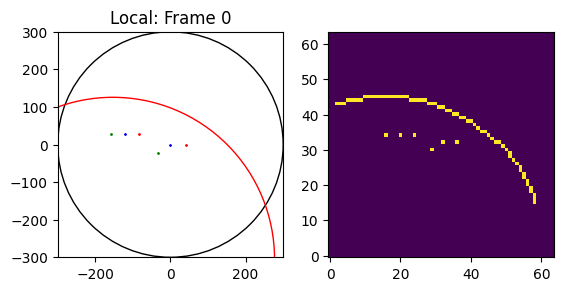

In [524]:
Observer_index=1
fig, [ax1,ax2] = plt.subplots(nrows=1, ncols=2)
t_start=0
def animate(i):
    ax1.clear()
    ax2.clear()
    i+=t_start
    Each_obs_index=Observed_index[i,Observer_index]
    CM_x=Observed_distance[i,Observer_index,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index])
    CM_y=Observed_distance[i,Observer_index,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index])
    ax1.plot(L1[i,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index])+CM_x, \
            L1[i,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index])+CM_y, \
                'o', color='red', markersize=1)
    ax1.plot(CM_x,CM_y, \
                'o', color='blue', markersize=1)
    ax1.plot(L2[i,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index]+np.pi+theta[i,Each_obs_index])+CM_x, \
            L2[i,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index]+Observed_head_phi[i,Observer_index,Each_obs_index]+np.pi+theta[i,Each_obs_index])+CM_y, 'o', color='green', markersize=1)
    circle = plt.Circle((0, 0), R, color='black', fill=False)
    ax1.add_artist(circle)
    ax1.set_xlim(-R, R)
    ax1.set_ylim(-R, R)
    ax1.set_title(f"Local: Frame {i}")
    ax1.set_aspect('equal', adjustable='box')
    if Radius[i,Observer_index]!=-1:
        circle=plt.Circle(((r-Radius[i,Observer_index])*np.cos(-global_head_phi[i,Observer_index]), -(r-Radius[i,Observer_index])*np.sin(-global_head_phi[i,Observer_index])), r, color='r',fill=False)
    ax1.add_patch(circle)
    Image=DiscreteImage(i, Observer_index=Observer_index)
    ax2.imshow(np.sum(Image, axis=0))
    ax2.invert_yaxis()
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())

In [513]:
OUTPUT=np.stack([L1_dot,L2_dot,theta_dot,v_para,v_norm,angular_speed],axis=2)

In [529]:
from tqdm import tqdm
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
NUM_EPOCHS=20
losses=[]
best_loss=0
model.to(device)
for epoch in range(NUM_EPOCHS):
    epoch_loss=[]
    for time in tqdm((~OUTLIER_INDEX).nonzero()[0]):
        input_data = np.zeros((INPUT.shape[1],4,grid,grid))
        for fish_id in range(INPUT.shape[1]):
            input_data[fish_id] = DiscreteImage(time,fish_id)
        input_data = torch.tensor(input_data, dtype=torch.float32).to(device)
        target_data = torch.tensor(OUTPUT[time], dtype=torch.float32).to(device)
        optimizer.zero_grad()
        output = model(input_data)
        loss = criterion(output, target_data)
        epoch_loss.append(loss.item())
        loss.backward()
        optimizer.step()
    losses.append(np.array(np.mean(epoch_loss)))
    if losses[-1] < best_loss or best_loss == 0:
        best_loss = losses[-1]
        torch.save(model.state_dict(), 'Model/Restnet18.pt')
    print(f"Epoch {epoch+1}/{NUM_EPOCHS}, Loss: {losses[-1]}")

cuda


100%|██████████| 16900/16900 [03:40<00:00, 76.59it/s]


Epoch 1/20, Loss: 11.09516175509425


100%|██████████| 16900/16900 [03:44<00:00, 75.22it/s]


Epoch 2/20, Loss: 10.952742525276523


100%|██████████| 16900/16900 [03:36<00:00, 78.13it/s]


Epoch 3/20, Loss: 10.39658972957651


100%|██████████| 16900/16900 [03:41<00:00, 76.31it/s]


Epoch 4/20, Loss: 10.261728818584563


100%|██████████| 16900/16900 [03:41<00:00, 76.31it/s]


Epoch 5/20, Loss: 10.226219636409505


100%|██████████| 16900/16900 [03:44<00:00, 75.20it/s]


Epoch 6/20, Loss: 10.192297972639107


100%|██████████| 16900/16900 [03:57<00:00, 71.15it/s]


Epoch 7/20, Loss: 10.11343061100934


100%|██████████| 16900/16900 [03:53<00:00, 72.27it/s]


Epoch 8/20, Loss: 10.08013786506988


100%|██████████| 16900/16900 [03:38<00:00, 77.23it/s]


Epoch 9/20, Loss: 9.99649416848444


100%|██████████| 16900/16900 [03:42<00:00, 76.01it/s]


Epoch 10/20, Loss: 9.931785221244457


100%|██████████| 16900/16900 [03:51<00:00, 73.08it/s]


Epoch 11/20, Loss: 9.99653387217259


100%|██████████| 16900/16900 [03:52<00:00, 72.84it/s]


Epoch 12/20, Loss: 9.884749490175198


100%|██████████| 16900/16900 [03:48<00:00, 73.94it/s]


Epoch 13/20, Loss: 9.732341131315781


100%|██████████| 16900/16900 [03:51<00:00, 73.07it/s]


Epoch 14/20, Loss: 9.484462702658755


100%|██████████| 16900/16900 [03:59<00:00, 70.57it/s]


Epoch 15/20, Loss: 9.068205396606196


100%|██████████| 16900/16900 [03:46<00:00, 74.61it/s]


Epoch 16/20, Loss: 8.60170021603887


100%|██████████| 16900/16900 [03:43<00:00, 75.51it/s]


Epoch 17/20, Loss: 8.045561043646451


100%|██████████| 16900/16900 [04:00<00:00, 70.27it/s]


Epoch 18/20, Loss: 7.4705615684901465


100%|██████████| 16900/16900 [03:39<00:00, 76.98it/s]


Epoch 19/20, Loss: 6.900317516039462


100%|██████████| 16900/16900 [03:42<00:00, 75.81it/s]


Epoch 20/20, Loss: 6.323854208756569


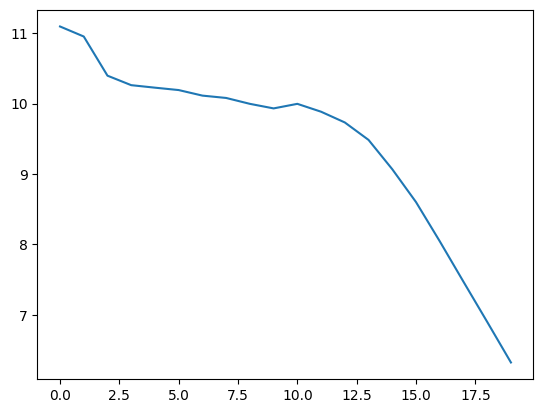

In [530]:
plt.plot(losses)

In [591]:
Test_frame=100
new_midline=np.zeros_like(midline[:Test_frame])
new_Observed_index=np.zeros_like(Observed_index[:Test_frame-1])
new_Observed_distance=np.zeros_like(Observed_distance[:Test_frame-1])
new_Observed_phi=np.zeros_like(Observed_phi[:Test_frame-1])
new_Observed_head_phi=np.zeros_like(Observed_head_phi[:Test_frame-1])
new_L1=np.zeros_like(L1[:Test_frame-1])
new_L2=np.zeros_like(L2[:Test_frame-1])
new_theta=np.zeros_like(theta[:Test_frame-1])
new_Radius=np.zeros_like(Radius[:Test_frame-1])
new_global_head_phi=np.zeros_like(global_head_phi[:Test_frame-1])

new_midline[0]=midline[0]

Predict_output=np.zeros((Test_frame, 2, 6))
with torch.no_grad():
    for i in tqdm(range(Test_frame-1)):
        new_head                =new_midline[i,:,0,:]-new_midline[i,:,1,:]
        new_tail                =new_midline[i,:,2,:]-new_midline[i,:,1,:]
        new_position            =new_midline[i,:,1,:]-DATA_circle[None,:2]
        new_global_head_phi[i]  =angle_between_2vec(new_head,-new_position, axis=1)
        new_theta[i]            =angle_between_2vec(-new_head, new_tail, axis=1)
        new_L1[i]               =np.linalg.norm(new_head, axis=1)
        new_L2[i]               =np.linalg.norm(new_tail, axis=1)
        new_Observed_vector     =new_midline[i,None,:,1,:]-new_midline[i,:,None,1,:]
        new_Observed_distance[i]=np.linalg.norm(new_Observed_vector, axis=2)
        new_Observed_phi[i]     =angle_between_2vec(new_head[:,None,:], new_Observed_vector, axis=2)
        new_Observed_head_phi[i]=angle_between_2vec(new_Observed_vector,new_head[None,:,:], axis=2)
        new_Observed_index[i]   =new_Observed_distance[i]<=R
        new_Radius[i]=r-np.linalg.norm(new_position, axis=1)
        new_Radius[i,new_Radius[i]>R]=-1

        input_data              = np.zeros((INPUT.shape[1],4,grid,grid))
        for fish_id in range(INPUT.shape[1]):
            input_data[fish_id] = DiscreteImage(i,fish_id,Observed_index=new_Observed_index,Observed_distance=new_Observed_distance,Observed_phi=new_Observed_phi,L1=new_L1,L2=new_L2,theta=new_theta,Radius=new_Radius,global_head_phi=new_global_head_phi,Observed_head_phi=new_Observed_head_phi)
        input_data = torch.tensor(input_data, dtype=torch.float32).to(device)
        Predict_output[i] = model(input_data).detach().cpu().numpy()
        new_midline[i+1]=Move(new_midline[i],Predict_output[i,:,0],Predict_output[i,:,1],Predict_output[i,:,2], Predict_output[i,:,3:])

100%|██████████| 99/99 [00:00<00:00, 105.31it/s]


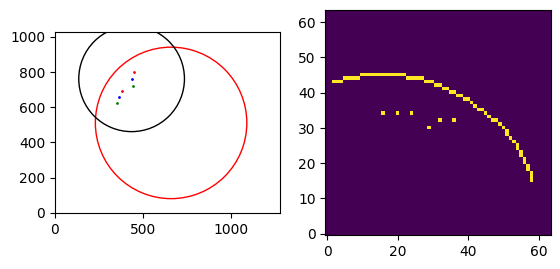

In [593]:
Observer_index=1
fig, [ax1,ax2] = plt.subplots(nrows=1, ncols=2)
t_start=0
def animate(i):
    ax1.clear()
    ax2.clear()
    i+=t_start
    ax1.set_xlim(0, vid.shape[1])
    ax1.set_ylim(0, vid.shape[0])
    ax1.set_aspect('equal', adjustable='box')
    circle = plt.Circle((x,y), r, color='red', fill=False)
    ax1.add_patch(circle)
    ax1.plot(new_midline[i,:,0,0], new_midline[i,:,0,1], 'o', color='red', markersize=1)
    ax1.plot(new_midline[i,:,1,0], new_midline[i,:,1,1], 'o', color='blue', markersize=1)
    ax1.plot(new_midline[i,:,2,0], new_midline[i,:,2,1], 'o', color='green', markersize=1)
    circle = plt.Circle((new_midline[i,Observer_index,1,0], new_midline[i,Observer_index,1,1]), R, color='black', fill=False)
    ax1.add_patch(circle)
    Image=DiscreteImage(i,Observer_index,Observed_index=new_Observed_index,Observed_distance=new_Observed_distance,Observed_phi=new_Observed_phi,L1=new_L1,L2=new_L2,theta=new_theta,Radius=new_Radius,global_head_phi=new_global_head_phi,Observed_head_phi=new_Observed_head_phi)
    ax2.imshow(np.sum(Image, axis=0))
    ax2.invert_yaxis()
ani = FuncAnimation(fig, animate, frames=Test_frame-1, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())


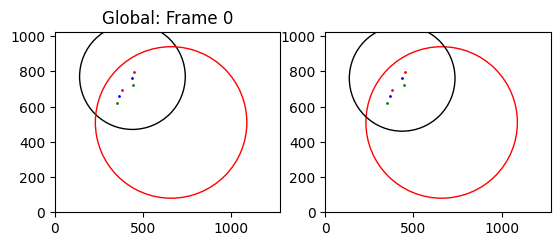

In [570]:
fig, [ax1,ax2] = plt.subplots(nrows=1, ncols=2)
def animate(i):
    ax1.clear()
    ax2.clear()
    ax1.plot(midline[i,:,0,0], midline[i,:,0,1], 'o', color='red', markersize=1)
    ax1.plot(midline[i,:,1,0], midline[i,:,1,1], 'o', color='blue', markersize=1)
    ax1.plot(midline[i,:,2,0], midline[i,:,2,1], 'o', color='green', markersize=1)
    circle = plt.Circle((pos[i,Observer_index,0], pos[i,Observer_index,1]), R, color='black', fill=False)
    ax1.add_artist(circle)
    ax1.set_xlim(0, vid.shape[1])
    ax1.set_ylim(0, vid.shape[0])
    ax1.set_aspect('equal', adjustable='box')
    ax1.set_title(f"Global: Frame {i}")
    circle=plt.Circle((x, y), r, color='r',fill=False)
    ax1.add_patch(circle)
    circle=plt.Circle((x, y), r, color='r',fill=False)
    ax2.set_xlim(0, vid.shape[1])
    ax2.set_ylim(0, vid.shape[0])
    ax2.set_aspect('equal', adjustable='box')
    ax2.add_patch(circle)
    ax2.plot(new_midline[i,:,0,0], new_midline[i,:,0,1], 'o', color='red', markersize=1)
    ax2.plot(new_midline[i,:,1,0], new_midline[i,:,1,1], 'o', color='blue', markersize=1)
    ax2.plot(new_midline[i,:,2,0], new_midline[i,:,2,1], 'o', color='green', markersize=1)
    circle = plt.Circle((new_midline[i,Observer_index,1,0], new_midline[i,Observer_index,1,1]), R, color='black', fill=False)
    ax2.add_patch(circle)
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
HTML(ani.to_jshtml())